# Plot signatures

This notebook generates some static plots of spatial signatures. We have a series of custom MapBox basemaps that need an API token. You will need to create and pass your own token to reproduce the figures.

## Spatial Signatures

In [2]:
import geopandas as gpd
from shapely.geometry import Point
import urbangrammar_graphics as ugg
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.lines import Line2D
import contextily

In [3]:
sns.set(context="paper", style="ticks", rc={'patch.force_edgecolor': False})

In [4]:
spsig = gpd.read_parquet("../../urbangrammar_samba/spatial_signatures/signatures/signatures_combined_levels_simplified.pq")

In [5]:
spsig.signature_type.unique()

array(['0_0', '1_0', '3_0', '4_0', '5_0', '6_0', '7_0', '8_0', '2_0',
       '2_1', '2_2', '9_0', '9_1', '9_2', '9_3', '9_4', '9_5', '9_6',
       '9_7', '9_8'], dtype=object)

In [6]:
cmap = ugg.get_colormap(spsig.signature_type.nunique(), randomize=False)

In [7]:
cols = cmap.colors

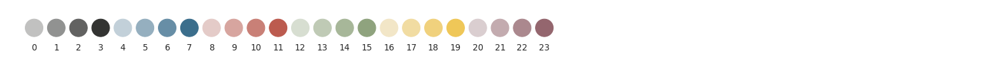

In [8]:
fig, ax = plt.subplots(figsize=(20, 5))
for i, c in enumerate(cols):
    ax.add_artist(plt.Circle((i, 0), 0.4, color=c))
    plt.text(i, -1, i, horizontalalignment='center')
    ax.set_axis_off()
    ax.set_aspect(1)
    ax.autoscale()
    plt.xlim(-1.25,43.25)
    plt.ylim(-1,1)

In [9]:
symbology = {'0_0': cols[16],
             '1_0': cols[15],
             '3_0': cols[9],
             '4_0': cols[12],
             '5_0': cols[21],
             '6_0': cols[8],
             '7_0': cols[4],
             '8_0': cols[18],
             '2_0': cols[6],
             '2_1': cols[23],
             '2_2': cols[19],
             '9_0': cols[7],
             '9_1': cols[3],
             '9_2': cols[22],
             '9_3': cols[0], # outlier
             '9_4': cols[11],
             '9_5': cols[14],
             '9_6': cols[0], # outlier
             '9_7': cols[0], # outlier
             '9_8': cols[0], # outlier
            }

In [10]:
token = "pk.eyJ1IjoibWFydGluZmxlaXMiLCJhIjoiY2t3Zzlkb3p4MGtrYzJvbnZqOGpjZjZtNSJ9.ANK4NEb_I45ucD_BHZt-Mg"

In [11]:
spsig = spsig.to_crs(3857)

In [12]:
df = spsig

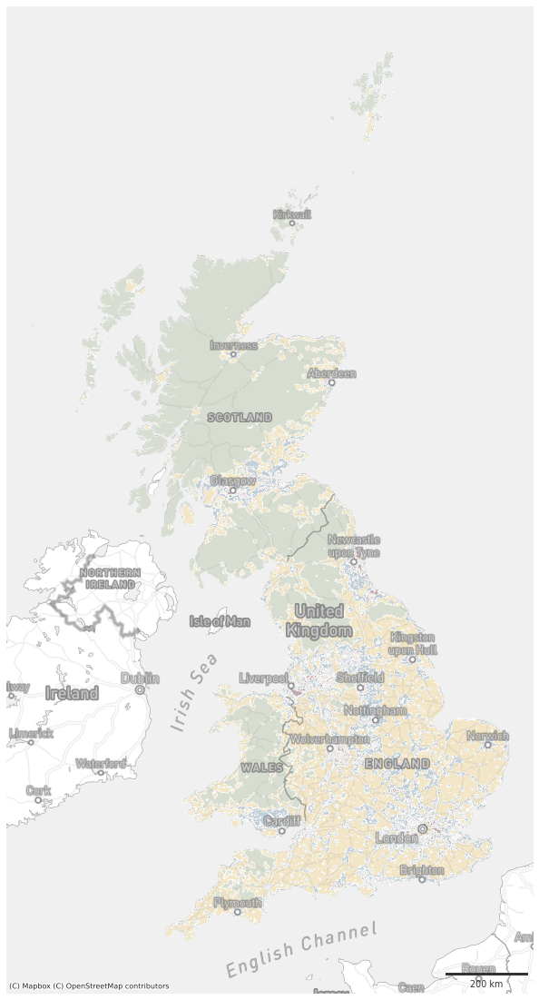

In [ ]:
ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/signatures_gb.png", dpi=300, bbox_inches="tight")

In [ ]:
london = gpd.GeoSeries([Point(-0.10875602230396436, 51.50933674406198)], crs=4326).to_crs(3857).buffer(35000).total_bounds

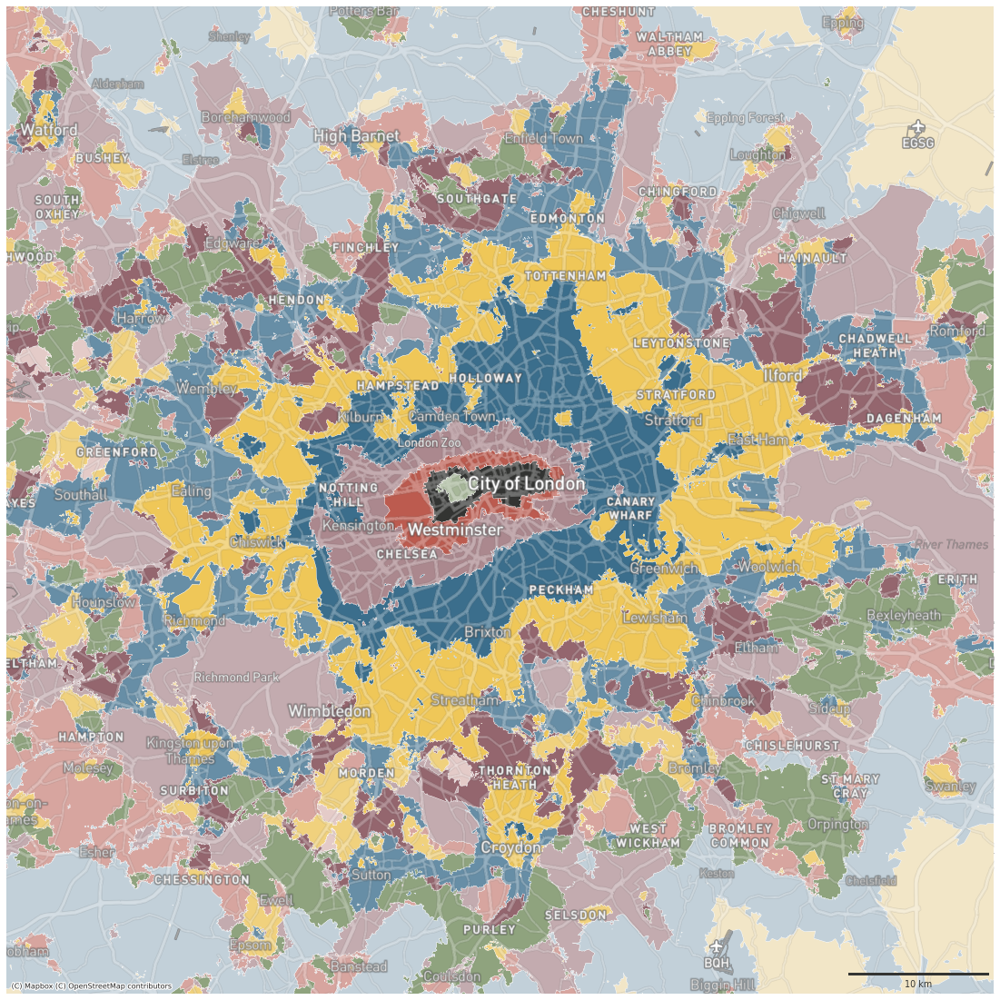

In [ ]:
ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(london[0], london[2])
ax.set_ylim(london[1], london[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/signatures_london.png", dpi=300, bbox_inches="tight")

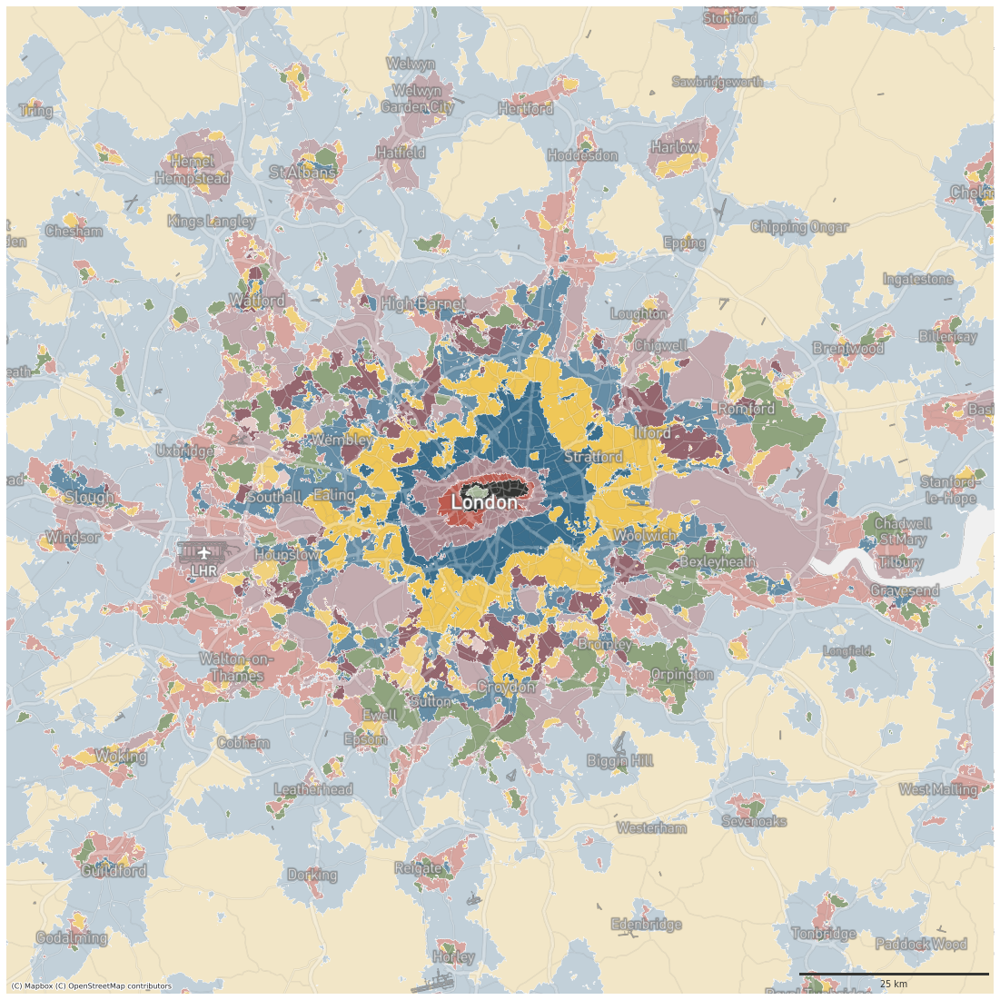

In [ ]:
london_metro = gpd.GeoSeries([Point(-0.10875602230396436, 51.50933674406198)], crs=4326).to_crs(3857).buffer(65000).total_bounds

ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(london_metro[0], london_metro[2])
ax.set_ylim(london_metro[1], london_metro[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/signatures_london_metro.png", dpi=300, bbox_inches="tight")

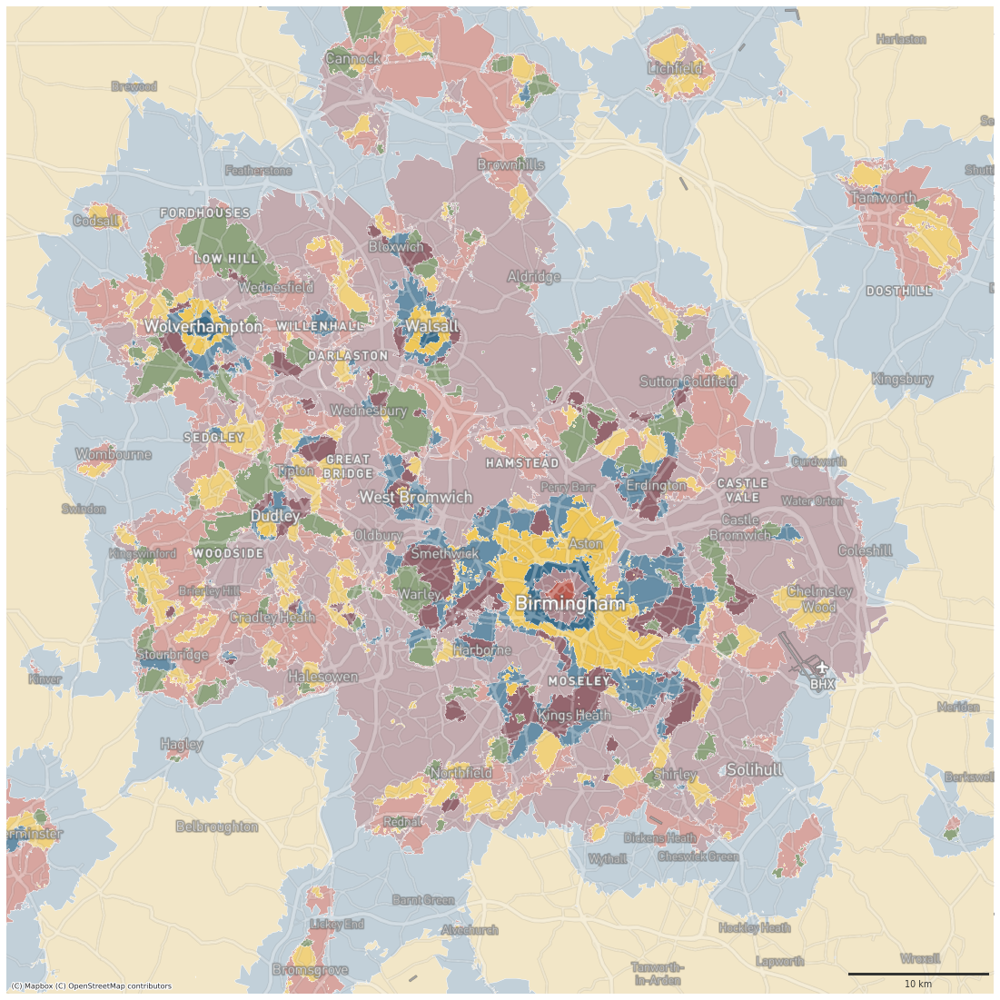

In [ ]:
birmingham = gpd.GeoSeries([Point(-1.9836323453459492, 52.51781818221639)], crs=4326).to_crs(3857).buffer(35000).total_bounds

ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(birmingham[0]+5000, birmingham[2]+5000)
ax.set_ylim(birmingham[1], birmingham[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/signatures_birmingham.png", dpi=300, bbox_inches="tight")

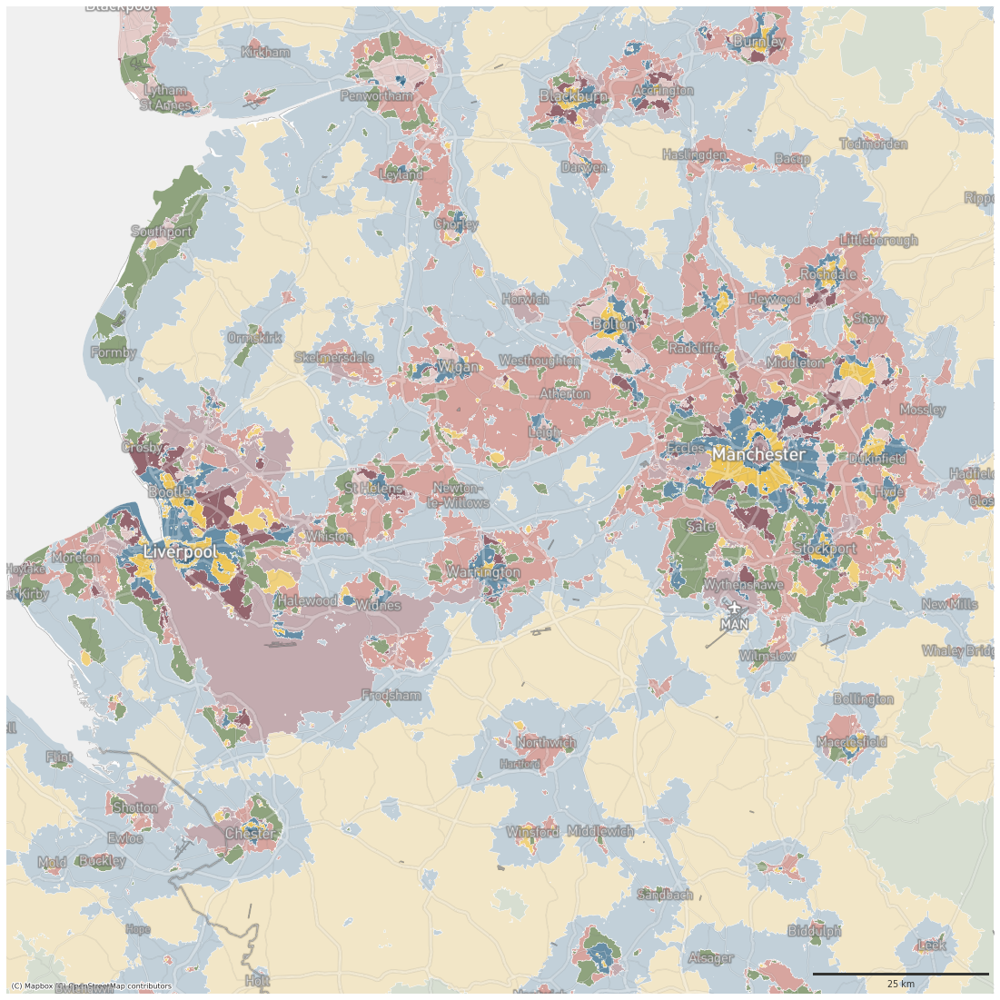

In [ ]:
lpool = gpd.GeoSeries([Point(-2.5731000246573963, 53.44502036089582,)], crs=4326).to_crs(3857).buffer(70000).total_bounds

ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(lpool[0], lpool[2])
ax.set_ylim(lpool[1], lpool[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/signatures_lpool.png", dpi=300, bbox_inches="tight")

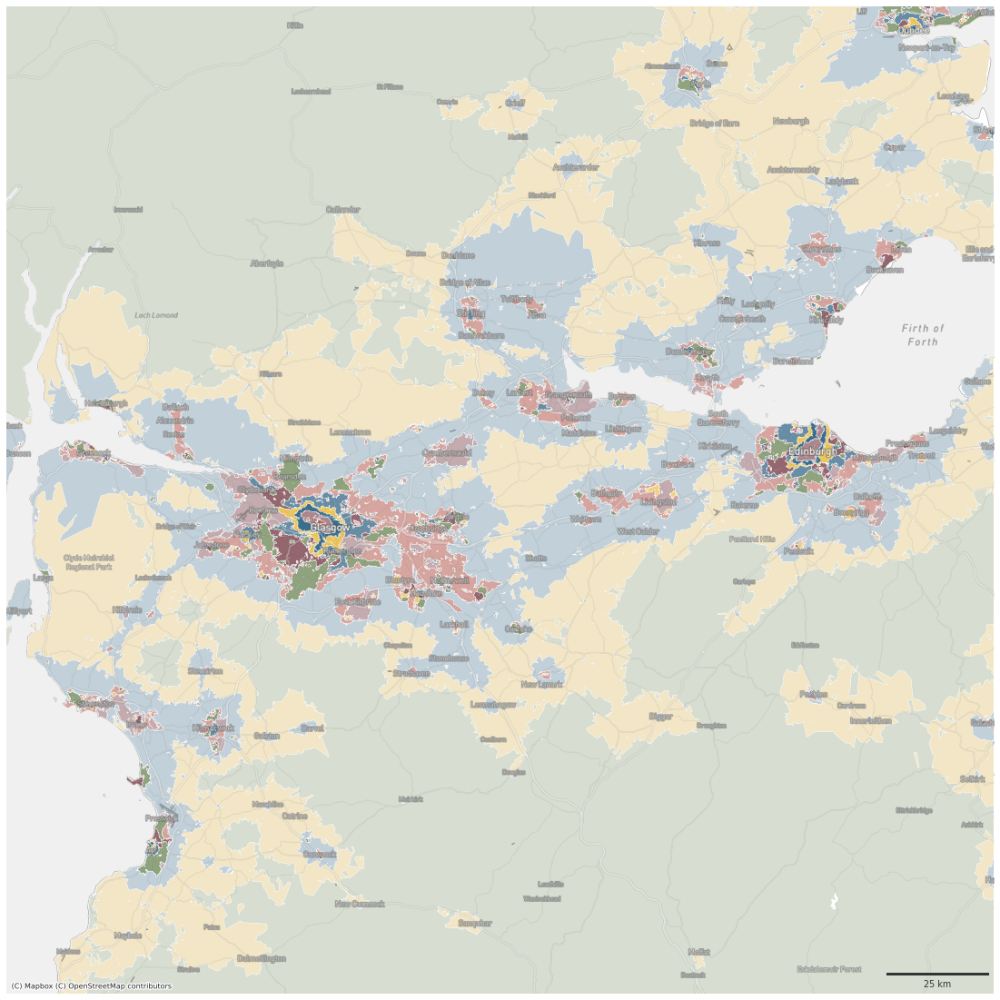

In [ ]:
belt = gpd.GeoSeries([Point(-3.8718635546837663, 55.89080727223461)], crs=4326).to_crs(3857).buffer(120000).total_bounds

ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(belt[0], belt[2])
ax.set_ylim(belt[1], belt[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/signatures_scottish_belt.png", dpi=300, bbox_inches="tight")

In [13]:
tyne = gpd.GeoSeries([Point(-1.6062, 54.9684)], crs=4326).to_crs(3857).buffer(35000).total_bounds

In [19]:
leg_points

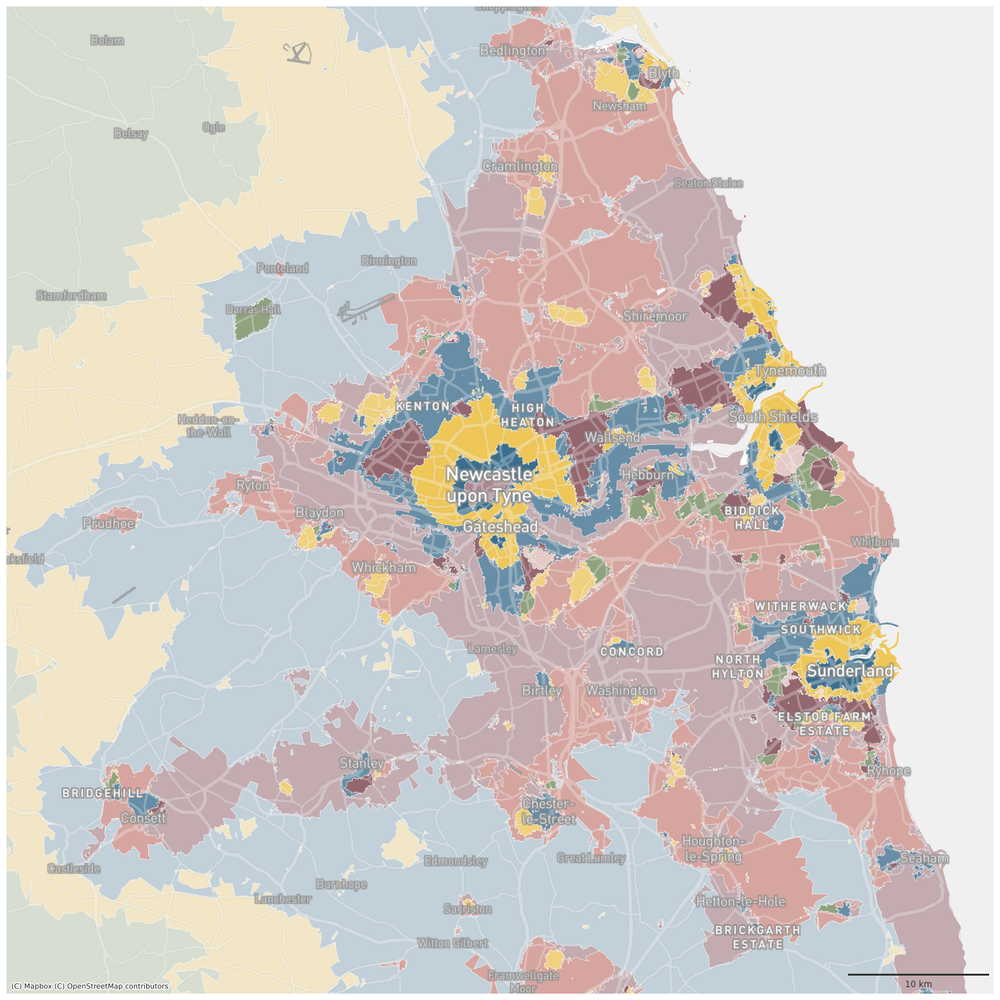

In [20]:
ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(tyne[0], tyne[2])
ax.set_ylim(tyne[1], tyne[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)

plt.savefig("figs/signatures_tyne.png", dpi=300, bbox_inches="tight")

## Form signatures

In [19]:
spsig = gpd.read_parquet("../../urbangrammar_samba/spatial_signatures/signatures/signatures_form_combined_levels_simplified.pq")

In [20]:
cmap = ugg.get_colormap(spsig.signature_type.nunique() - 4, randomize=False)

In [21]:
cols = cmap.colors

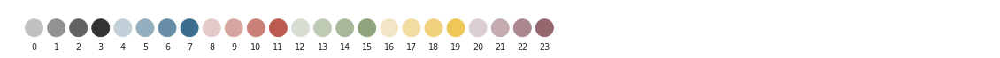

In [ ]:
fig, ax = plt.subplots(figsize=(20, 5))
for i, c in enumerate(cols):
    ax.add_artist(plt.Circle((i, 0), 0.4, color=c))
    plt.text(i, -1, i, horizontalalignment='center')
    ax.set_axis_off()
    ax.set_aspect(1)
    ax.autoscale()
    plt.xlim(-1.25,43.25)
    plt.ylim(-1,1)

In [23]:
spsig.signature_type.unique()

array(['0_0', '1_0', '3_0', '5_0', '6_0', '7_0', '2_0', '2_1', '2_2',
       '2_3', '2_4', '2_5', '2_6', '2_7', '4_0', '4_1', '4_2', '4_3',
       '4_4', '4_5', '4_6', '4_7', '4_8'], dtype=object)

In [24]:
symbology = {'0_0': cols[16],
             '1_0': cols[20],
             '3_0': cols[14],
             '4_0': cols[8],
             '5_0': cols[4],
             '6_0': cols[0], # outlier
             '7_0': cols[0], # outlier
             '2_0': cols[17],
             '2_1': cols[15],
             '2_2': cols[18],
             '2_3': cols[22],
             '2_4': cols[10],
             '2_5': cols[23],
             '2_6': cols[13],
             '2_7': cols[6],
             '4_0': cols[9],
             '4_1': cols[11],
             '4_2': cols[7],
             '4_3': cols[0], # outlier
             '4_4': cols[0], # outlier
             '4_5': cols[19],
             '4_6': cols[22],
             '4_7': cols[23],
             '4_8': cols[0], # outlier
            }

In [25]:
spsig = spsig.to_crs(3857)

In [26]:
df = spsig

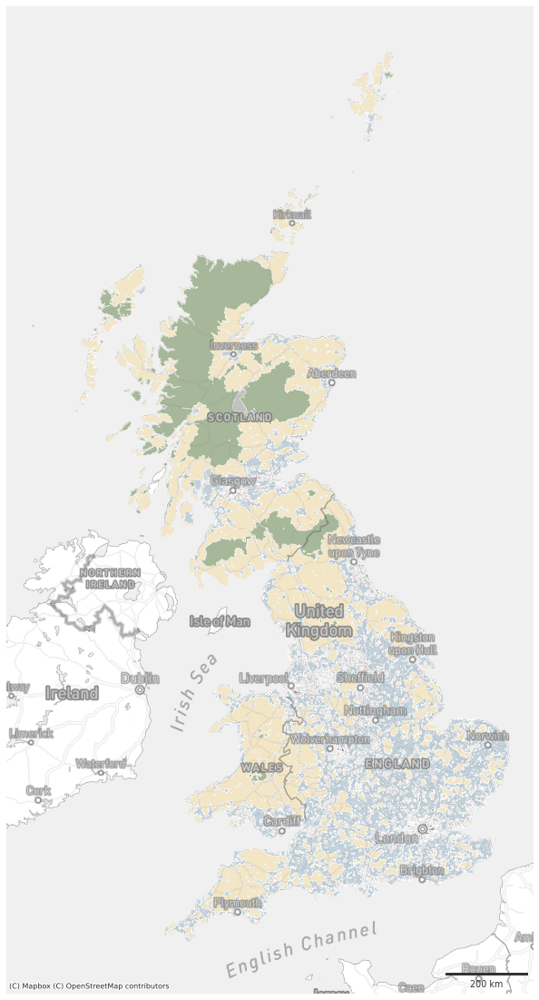

In [ ]:
ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_gb.png", dpi=300, bbox_inches="tight")

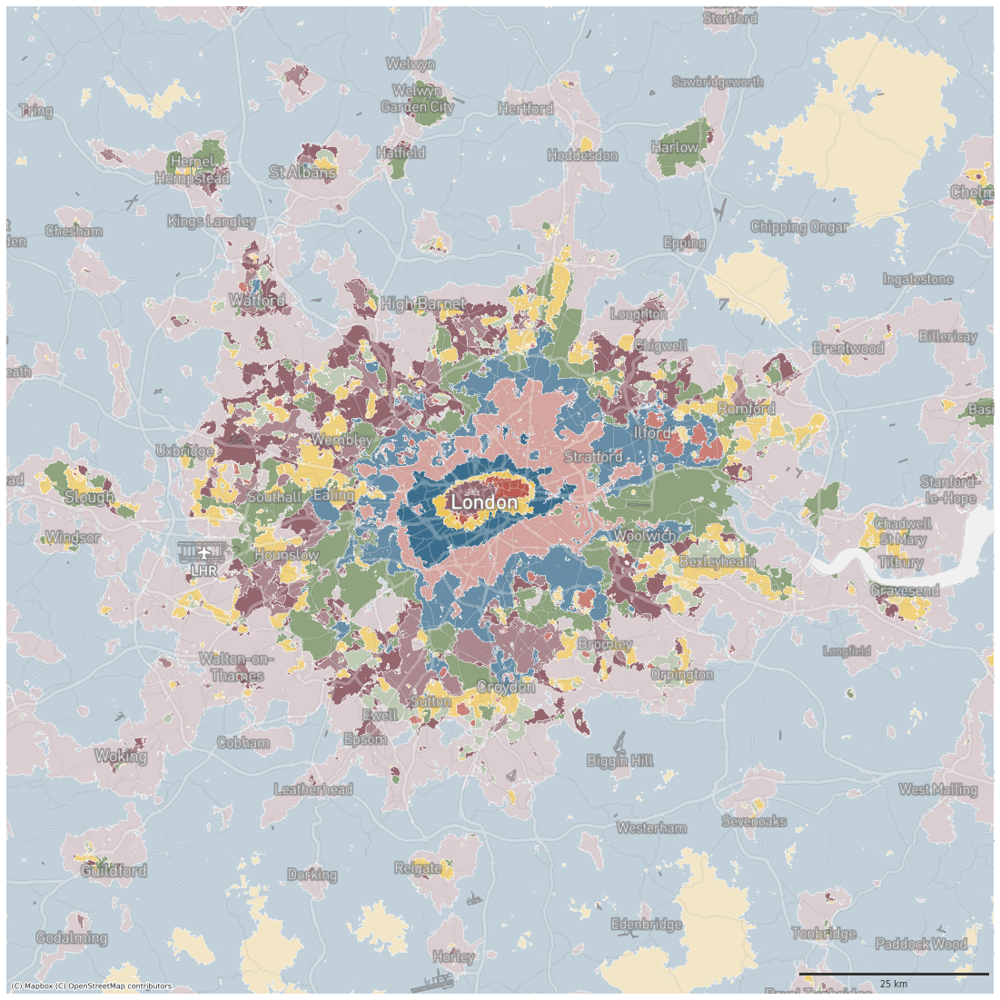

In [ ]:
london_metro = gpd.GeoSeries([Point(-0.10875602230396436, 51.50933674406198)], crs=4326).to_crs(3857).buffer(65000).total_bounds

ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(london_metro[0], london_metro[2])
ax.set_ylim(london_metro[1], london_metro[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_london_metro.png", dpi=72, bbox_inches="tight")

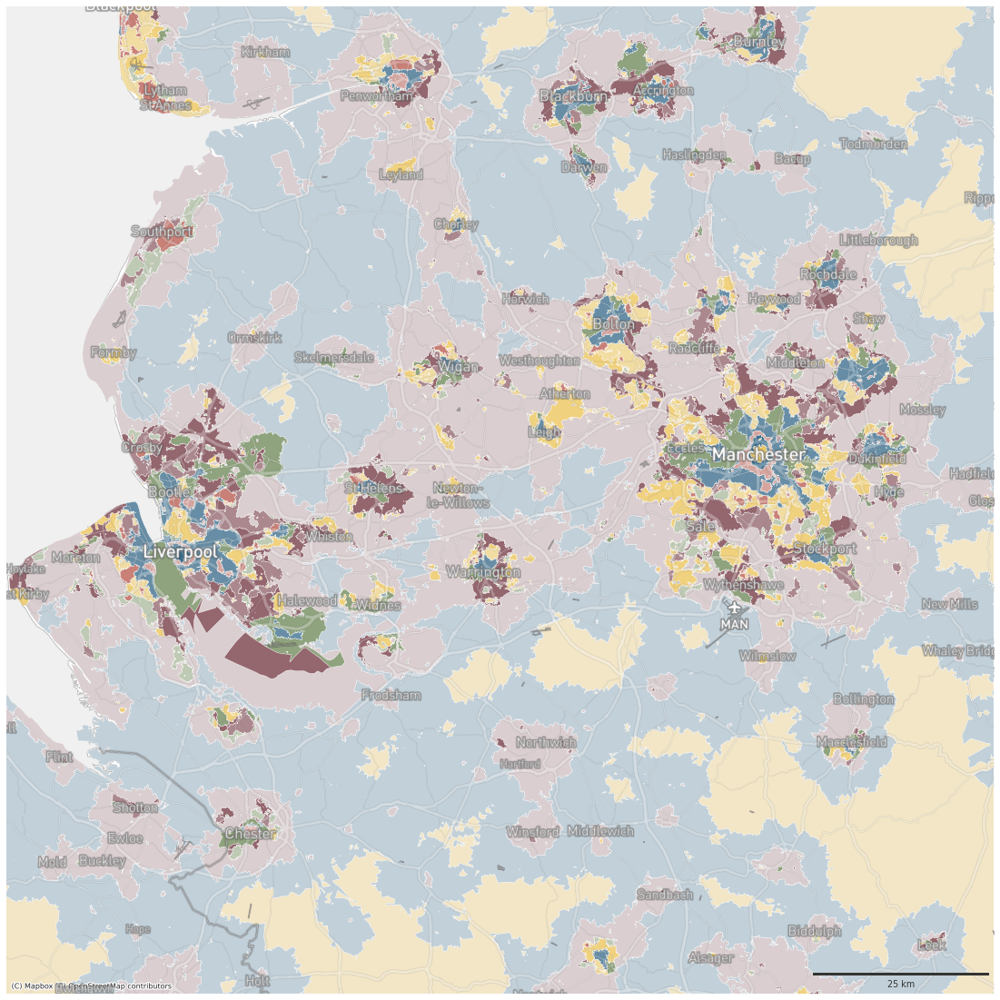

In [ ]:
lpool = gpd.GeoSeries([Point(-2.5731000246573963, 53.44502036089582,)], crs=4326).to_crs(3857).buffer(70000).total_bounds

ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(lpool[0], lpool[2])
ax.set_ylim(lpool[1], lpool[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_lpool.png", dpi=72, bbox_inches="tight")

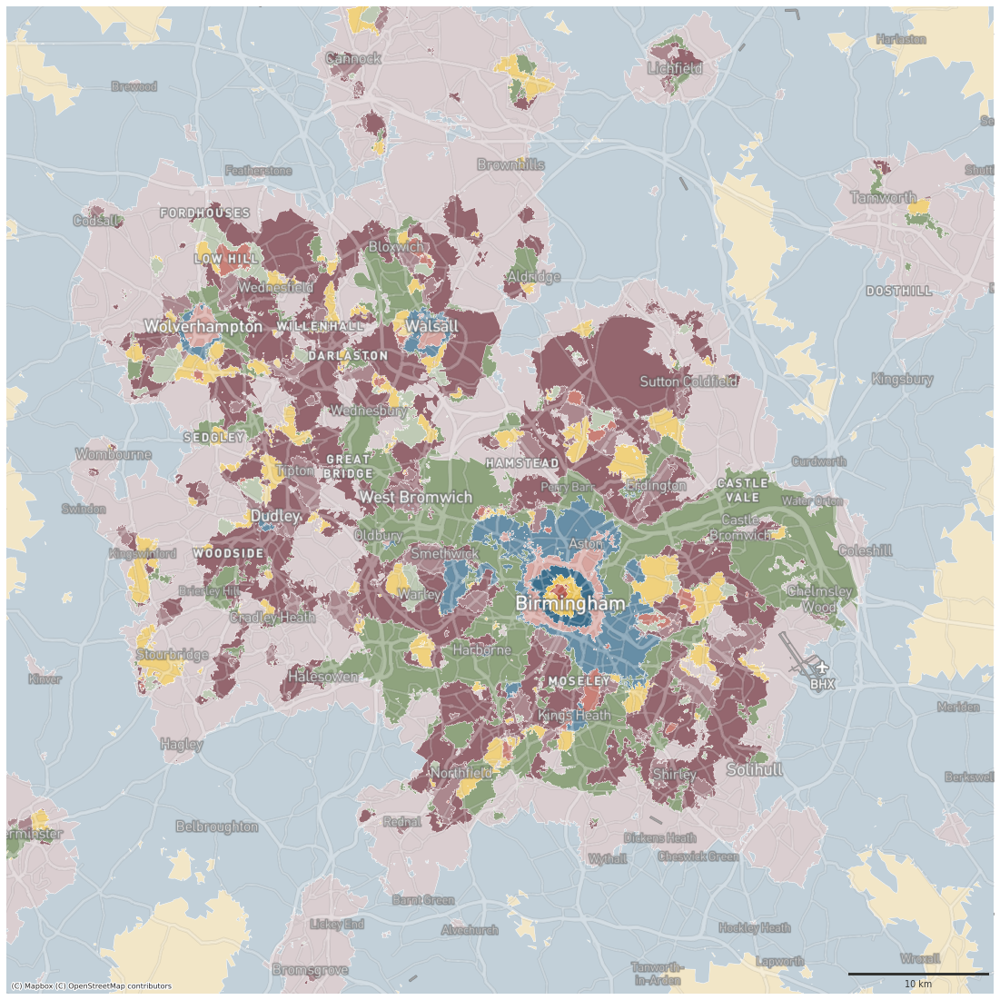

In [ ]:
birmingham = gpd.GeoSeries([Point(-1.9836323453459492, 52.51781818221639)], crs=4326).to_crs(3857).buffer(35000).total_bounds

ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(birmingham[0]+5000, birmingham[2]+5000)
ax.set_ylim(birmingham[1], birmingham[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_birmingham.png", dpi=72, bbox_inches="tight")

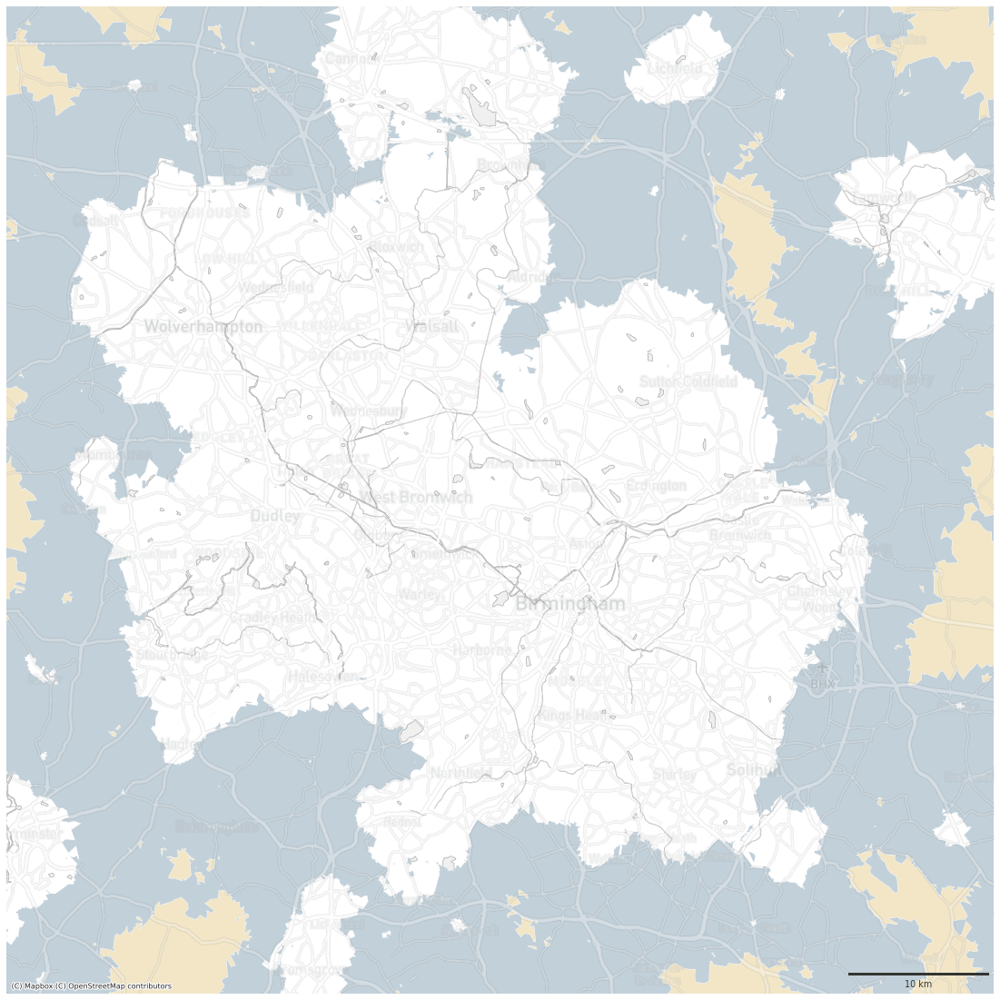

In [ ]:
birmingham = gpd.GeoSeries([Point(-1.9836323453459492, 52.51781818221639)], crs=4326).to_crs(3857).buffer(35000).total_bounds

selection = ['0_0', '3_0', '5_0', '7_0']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(birmingham[0]+5000, birmingham[2]+5000)
ax.set_ylim(birmingham[1], birmingham[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_birmingham_countryside.png", dpi=72, bbox_inches="tight")

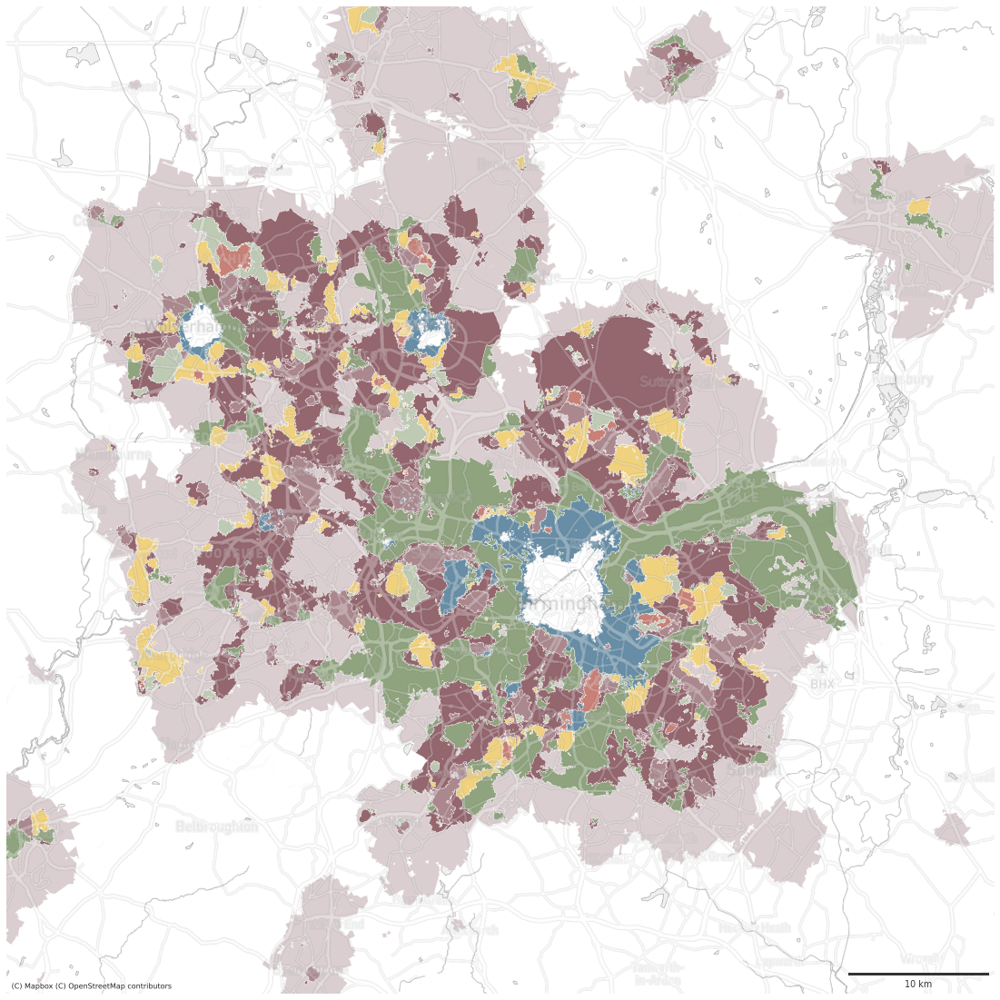

In [ ]:
birmingham = gpd.GeoSeries([Point(-1.9836323453459492, 52.51781818221639)], crs=4326).to_crs(3857).buffer(35000).total_bounds

selection = ['1_0', '2_0', '2_1', '2_2', '2_3', '2_4', '2_5', '2_6', '2_7']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(birmingham[0]+5000, birmingham[2]+5000)
ax.set_ylim(birmingham[1], birmingham[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_birmingham_periphery.png", dpi=72, bbox_inches="tight")

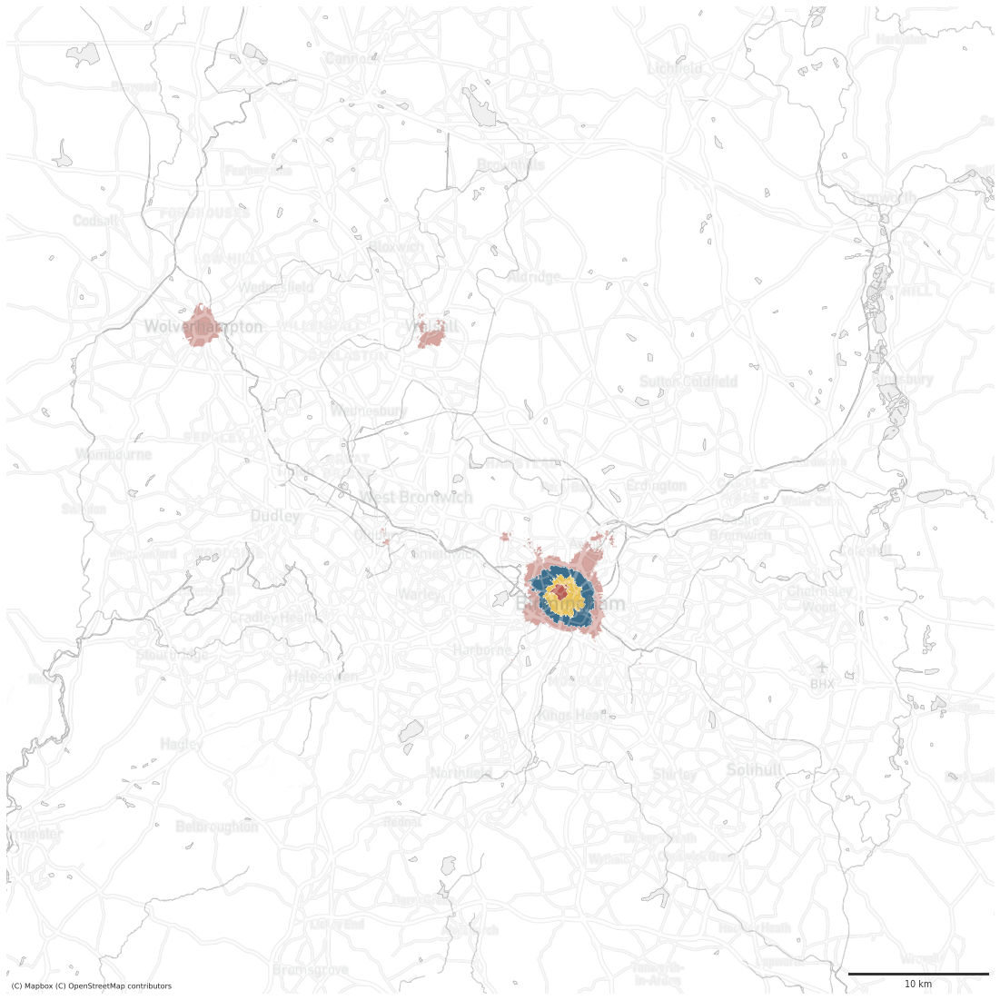

In [ ]:
birmingham = gpd.GeoSeries([Point(-1.9836323453459492, 52.51781818221639)], crs=4326).to_crs(3857).buffer(35000).total_bounds

selection = ['4_0', '4_1', '4_2', '4_3', '4_4', '4_5', '4_6', '4_7', '4_8']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(birmingham[0]+5000, birmingham[2]+5000)
ax.set_ylim(birmingham[1], birmingham[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_birmingham_centers.png", dpi=72, bbox_inches="tight")

In [ ]:
df.signature_type.unique()

array(['0_0', '1_0', '3_0', '5_0', '6_0', '7_0', '2_0', '2_1', '2_2',
       '2_3', '2_4', '2_5', '2_6', '2_7', '4_0', '4_1', '4_2', '4_3',
       '4_4', '4_5', '4_6', '4_7', '4_8'], dtype=object)

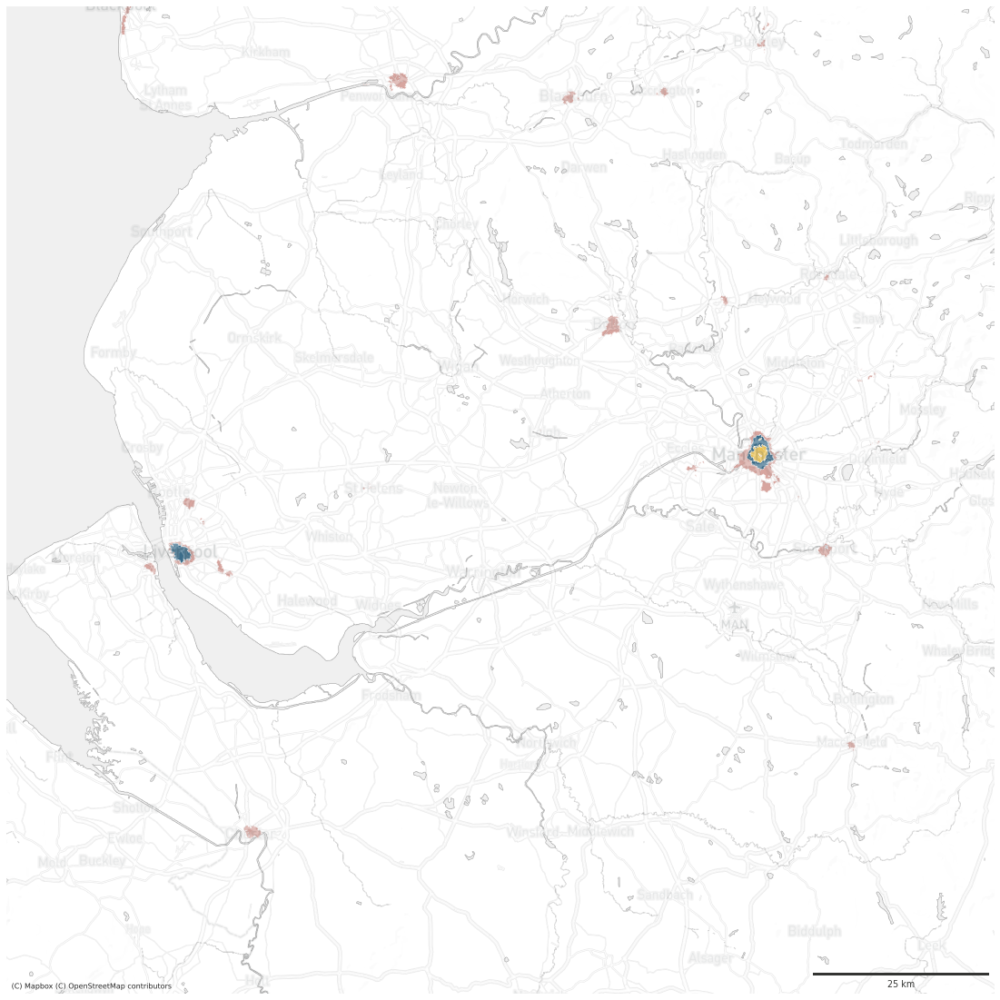

In [ ]:
lpool = gpd.GeoSeries([Point(-2.5731000246573963, 53.44502036089582,)], crs=4326).to_crs(3857).buffer(70000).total_bounds

selection = ['4_0', '4_1', '4_2', '4_3', '4_4', '4_5', '4_6', '4_7', '4_8']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(lpool[0], lpool[2])
ax.set_ylim(lpool[1], lpool[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_lpool_centers.png", dpi=72, bbox_inches="tight")

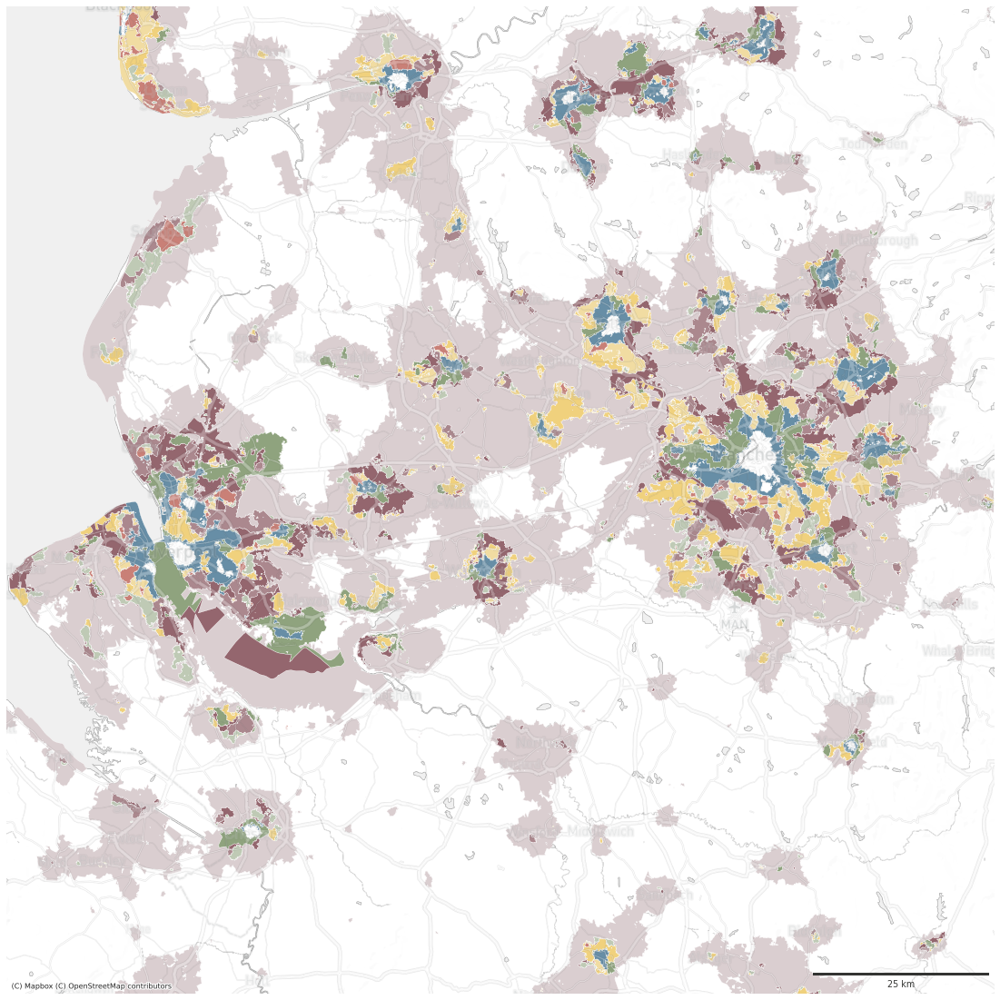

In [ ]:
lpool = gpd.GeoSeries([Point(-2.5731000246573963, 53.44502036089582,)], crs=4326).to_crs(3857).buffer(70000).total_bounds

selection = ['1_0', '2_0', '2_1', '2_2', '2_3', '2_4', '2_5', '2_6', '2_7']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(lpool[0], lpool[2])
ax.set_ylim(lpool[1], lpool[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_lpool_periphery.png", dpi=72, bbox_inches="tight")

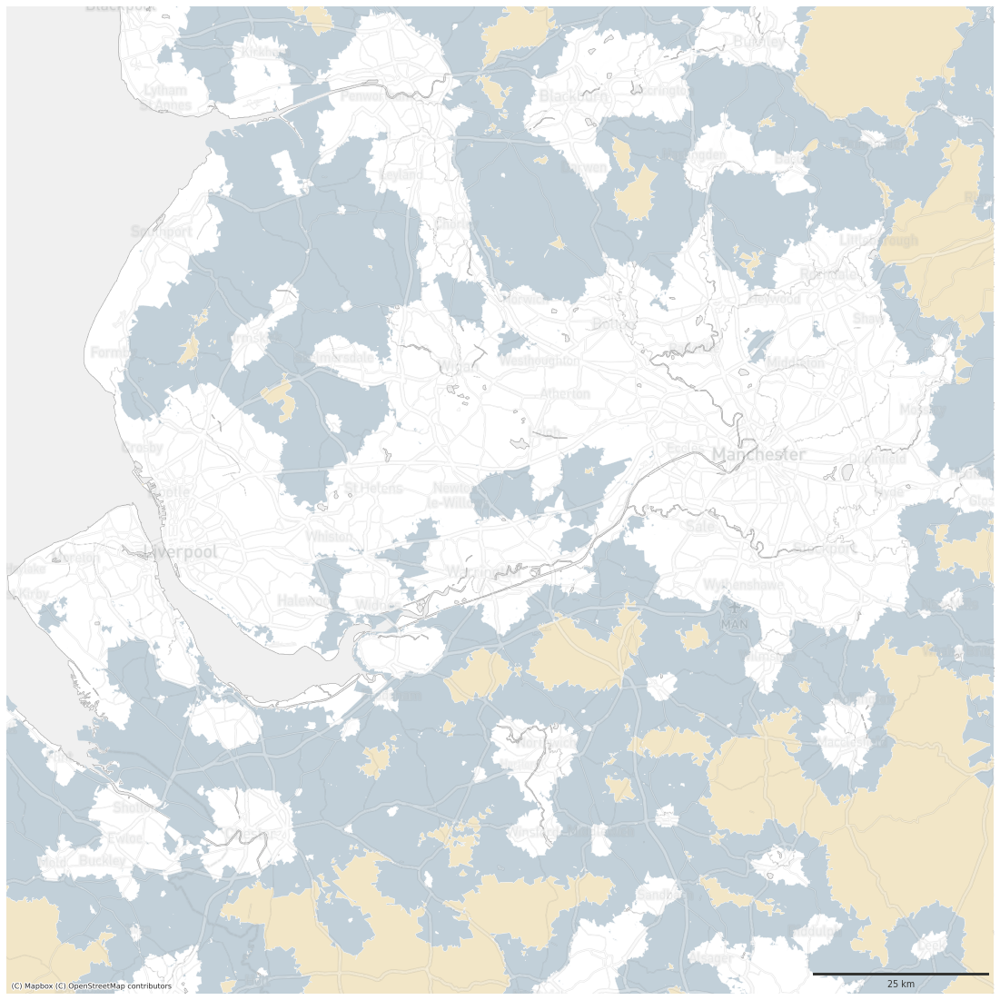

In [ ]:
lpool = gpd.GeoSeries([Point(-2.5731000246573963, 53.44502036089582,)], crs=4326).to_crs(3857).buffer(70000).total_bounds

selection = ['0_0', '3_0', '5_0', '7_0']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(lpool[0], lpool[2])
ax.set_ylim(lpool[1], lpool[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_lpool_countryside.png", dpi=72, bbox_inches="tight")

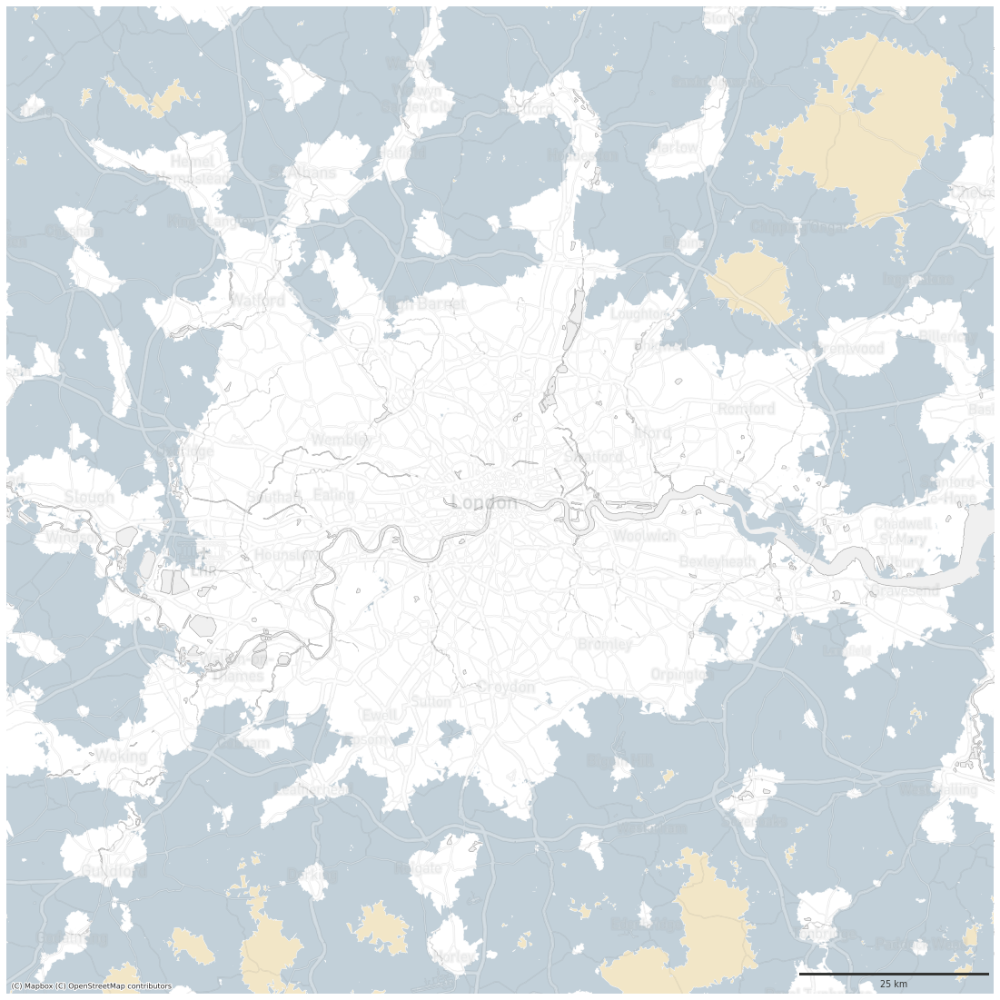

In [ ]:
london_metro = gpd.GeoSeries([Point(-0.10875602230396436, 51.50933674406198)], crs=4326).to_crs(3857).buffer(65000).total_bounds

aselection = ['0_0', '3_0', '5_0', '7_0']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(london_metro[0], london_metro[2])
ax.set_ylim(london_metro[1], london_metro[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_london_metro_countryside.png", dpi=72, bbox_inches="tight")

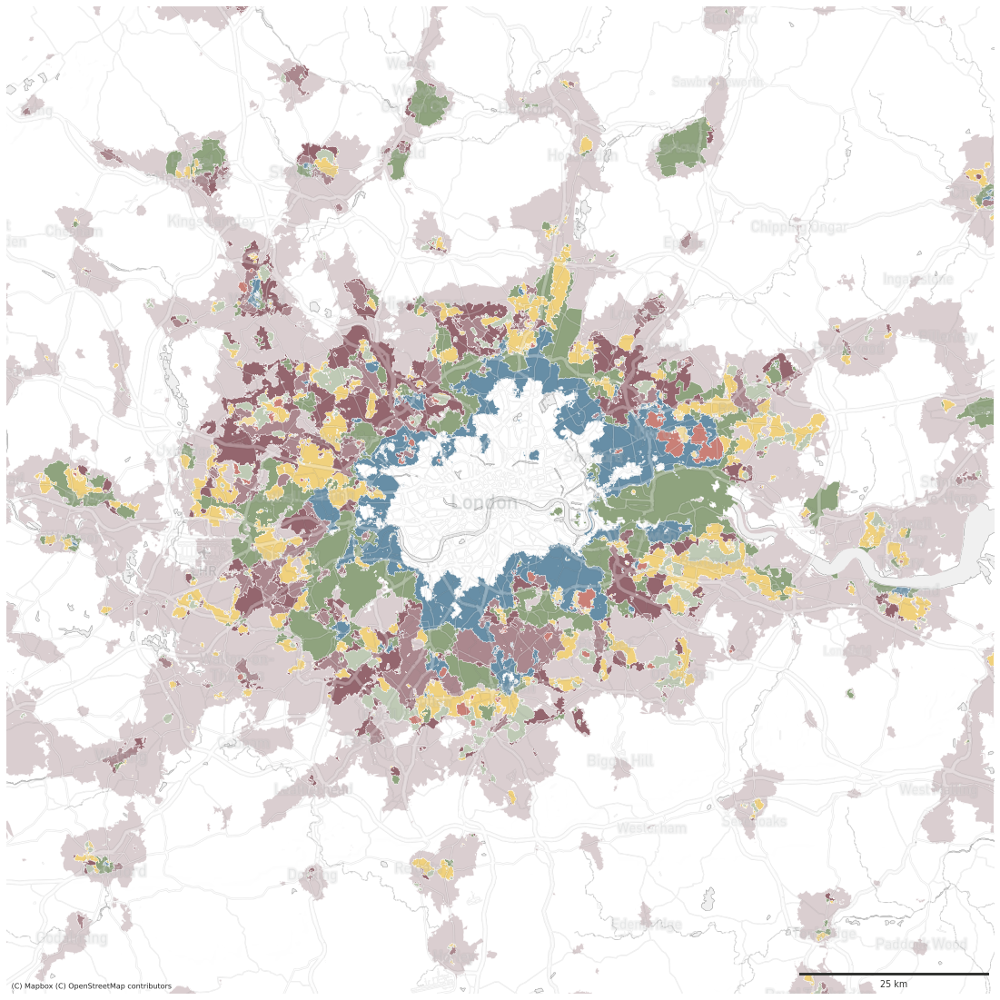

In [ ]:
london_metro = gpd.GeoSeries([Point(-0.10875602230396436, 51.50933674406198)], crs=4326).to_crs(3857).buffer(65000).total_bounds

selection = ['1_0', '2_0', '2_1', '2_2', '2_3', '2_4', '2_5', '2_6', '2_7']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(london_metro[0], london_metro[2])
ax.set_ylim(london_metro[1], london_metro[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_london_metro_periphery.png", dpi=72, bbox_inches="tight")

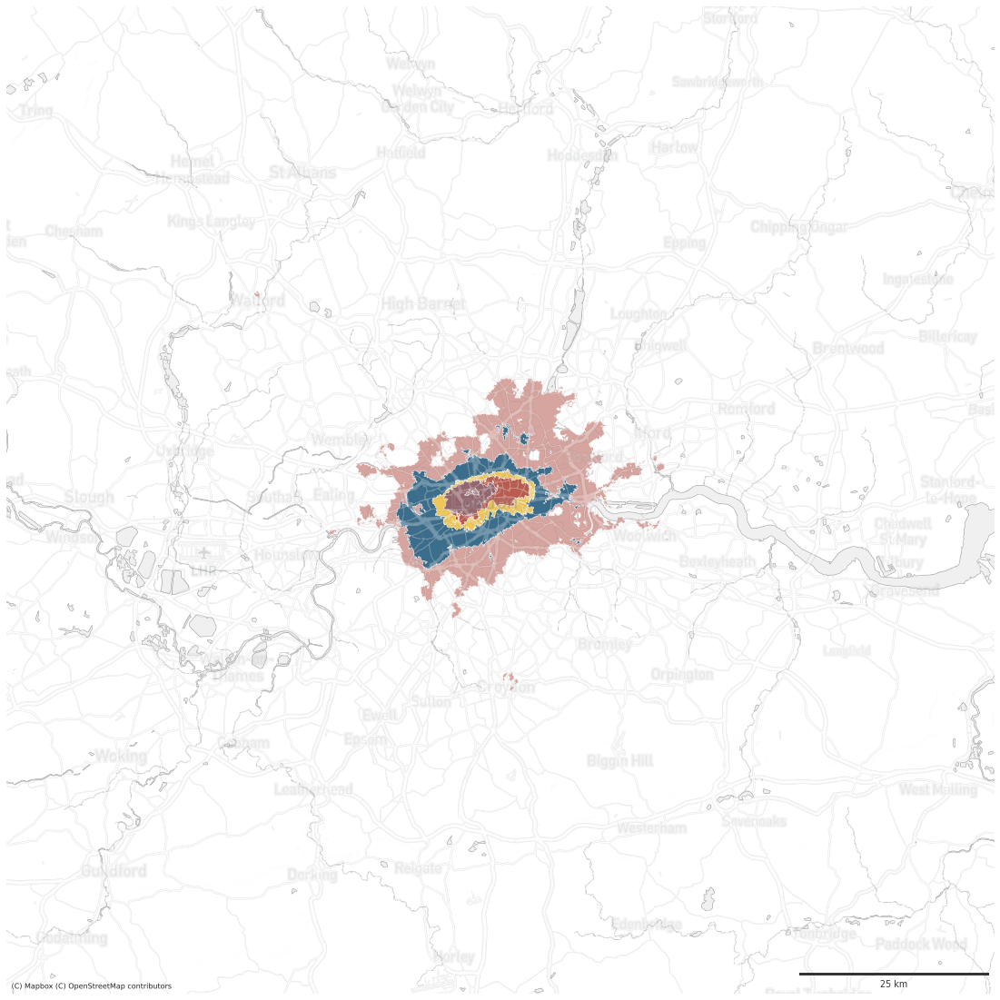

In [ ]:
london_metro = gpd.GeoSeries([Point(-0.10875602230396436, 51.50933674406198)], crs=4326).to_crs(3857).buffer(65000).total_bounds

selection = ['4_0', '4_1', '4_2', '4_3', '4_4', '4_5', '4_6', '4_7', '4_8']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(london_metro[0], london_metro[2])
ax.set_ylim(london_metro[1], london_metro[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_london_metro_centers.png", dpi=72, bbox_inches="tight")

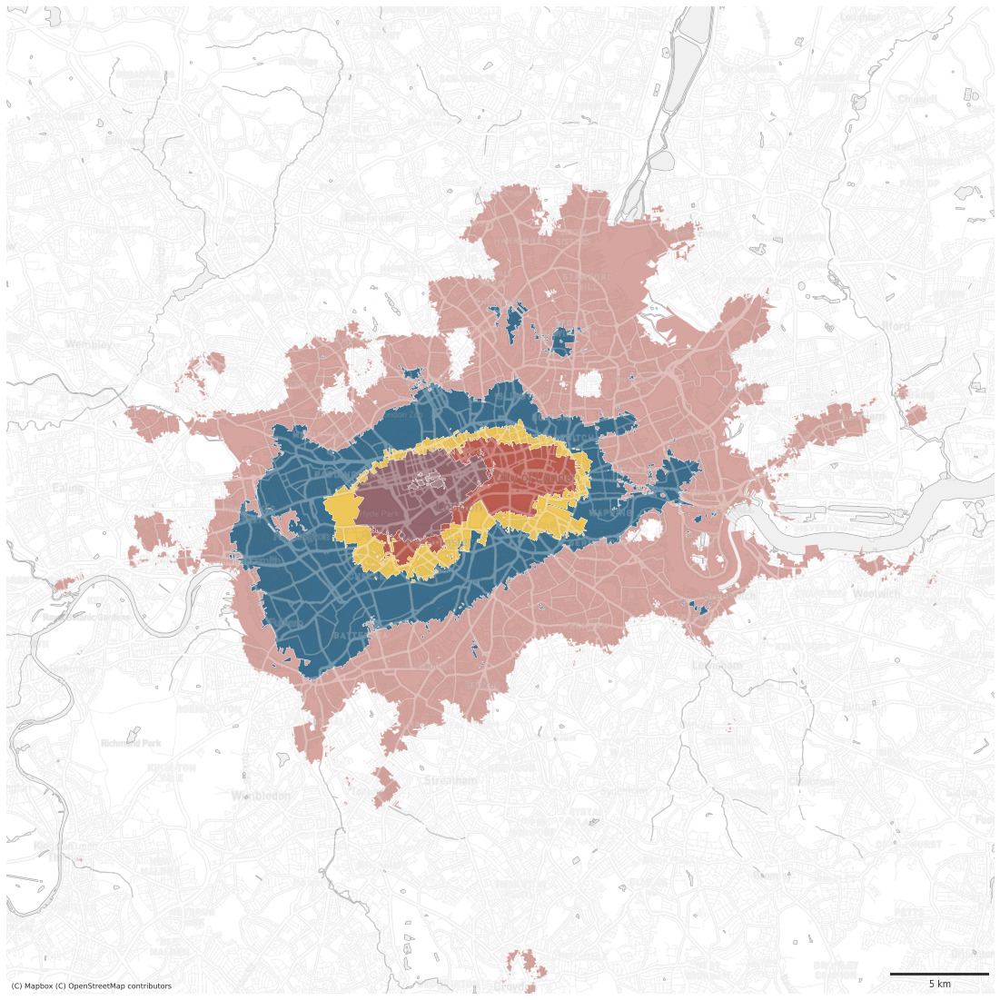

In [ ]:
london_centre = gpd.GeoSeries([Point(-0.10875602230396436, 51.50933674406198)], crs=4326).to_crs(3857).buffer(25000).total_bounds

selection = ['4_0', '4_1', '4_2', '4_3', '4_4', '4_5', '4_6', '4_7', '4_8']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(london_centre[0], london_centre[2])
ax.set_ylim(london_centre[1], london_centre[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_centres_lon.png", dpi=72, bbox_inches="tight")

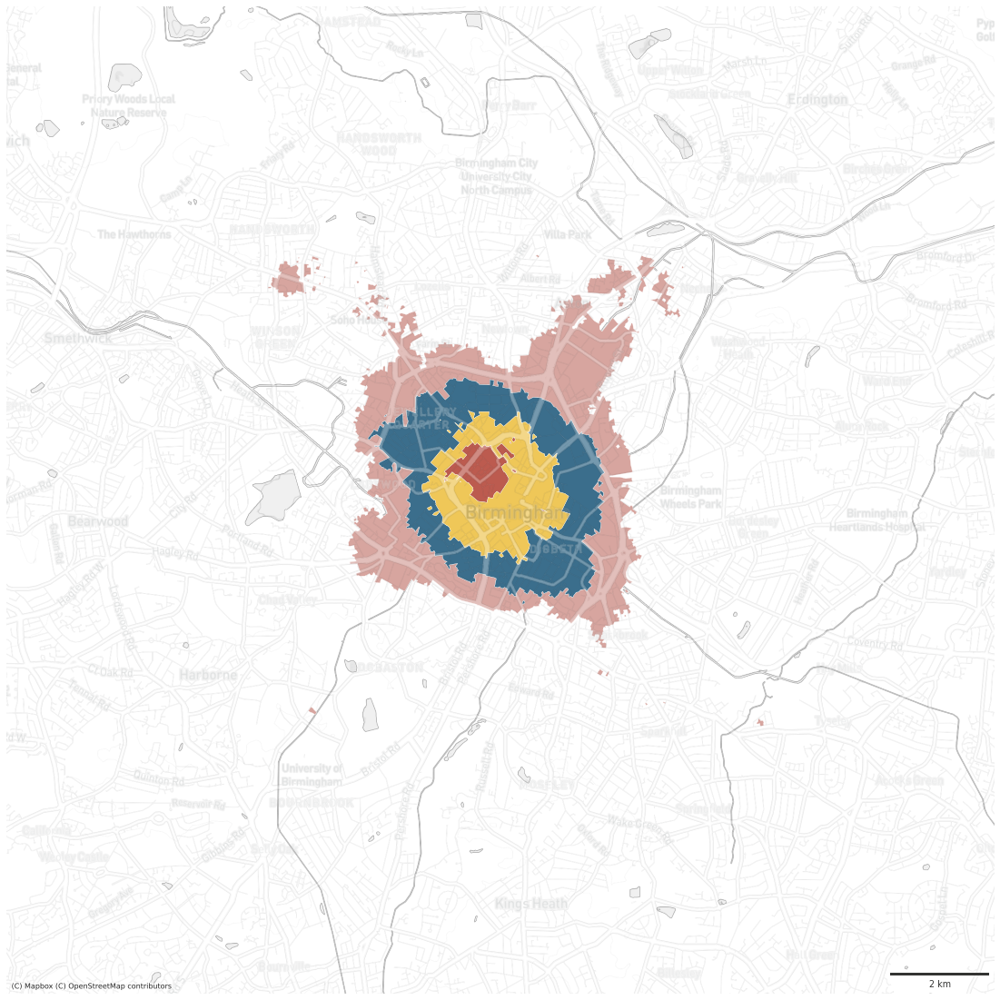

In [ ]:
bm_centre = gpd.GeoSeries([Point(-1.8972100769776854, 52.47897080235674)], crs=4326).to_crs(3857).buffer(10000).total_bounds

selection = ['4_0', '4_1', '4_2', '4_3', '4_4', '4_5', '4_6', '4_7', '4_8']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(bm_centre[0], bm_centre[2])
ax.set_ylim(bm_centre[1], bm_centre[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_centres_bm.png", dpi=72, bbox_inches="tight")

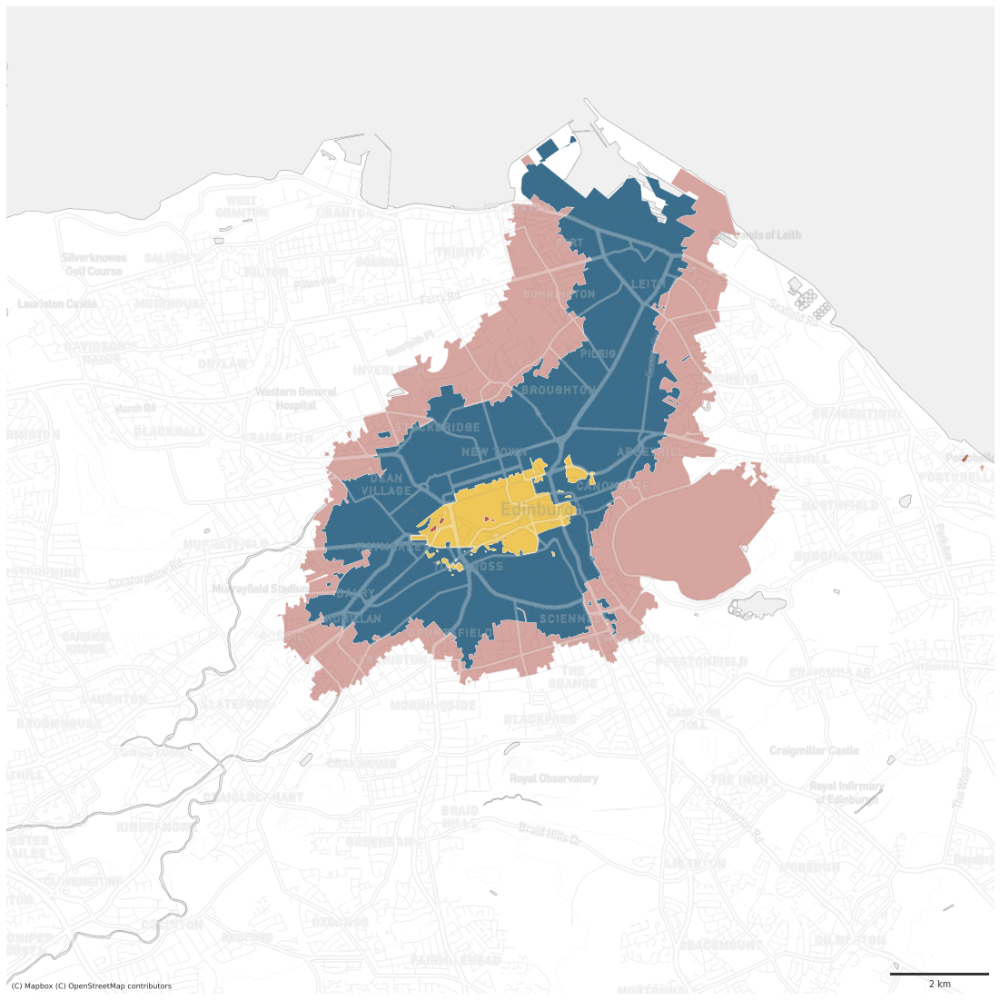

In [ ]:
bm_centre = gpd.GeoSeries([Point(-3.197898411700317,55.950647882576106,)], crs=4326).to_crs(3857).buffer(10000).total_bounds

selection = ['4_0', '4_1', '4_2', '4_3', '4_4', '4_5', '4_6', '4_7', '4_8']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(bm_centre[0], bm_centre[2])
ax.set_ylim(bm_centre[1], bm_centre[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_centres_edi.png", dpi=72, bbox_inches="tight")

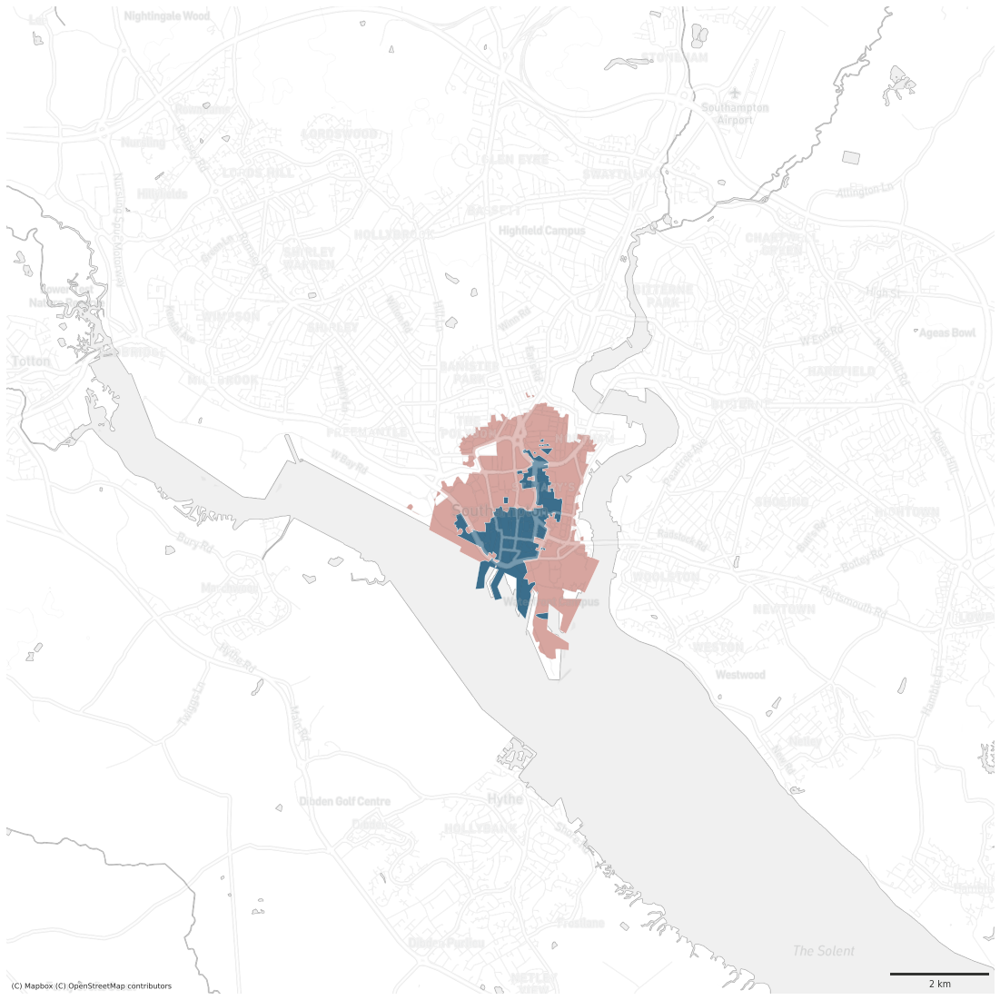

In [ ]:
bm_centre = gpd.GeoSeries([Point(-1.404116719292156, 50.90381337323079)], crs=4326).to_crs(3857).buffer(10000).total_bounds

selection = ['4_0', '4_1', '4_2', '4_3', '4_4', '4_5', '4_6', '4_7', '4_8']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(bm_centre[0], bm_centre[2])
ax.set_ylim(bm_centre[1], bm_centre[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_centres_soton.png", dpi=72, bbox_inches="tight")

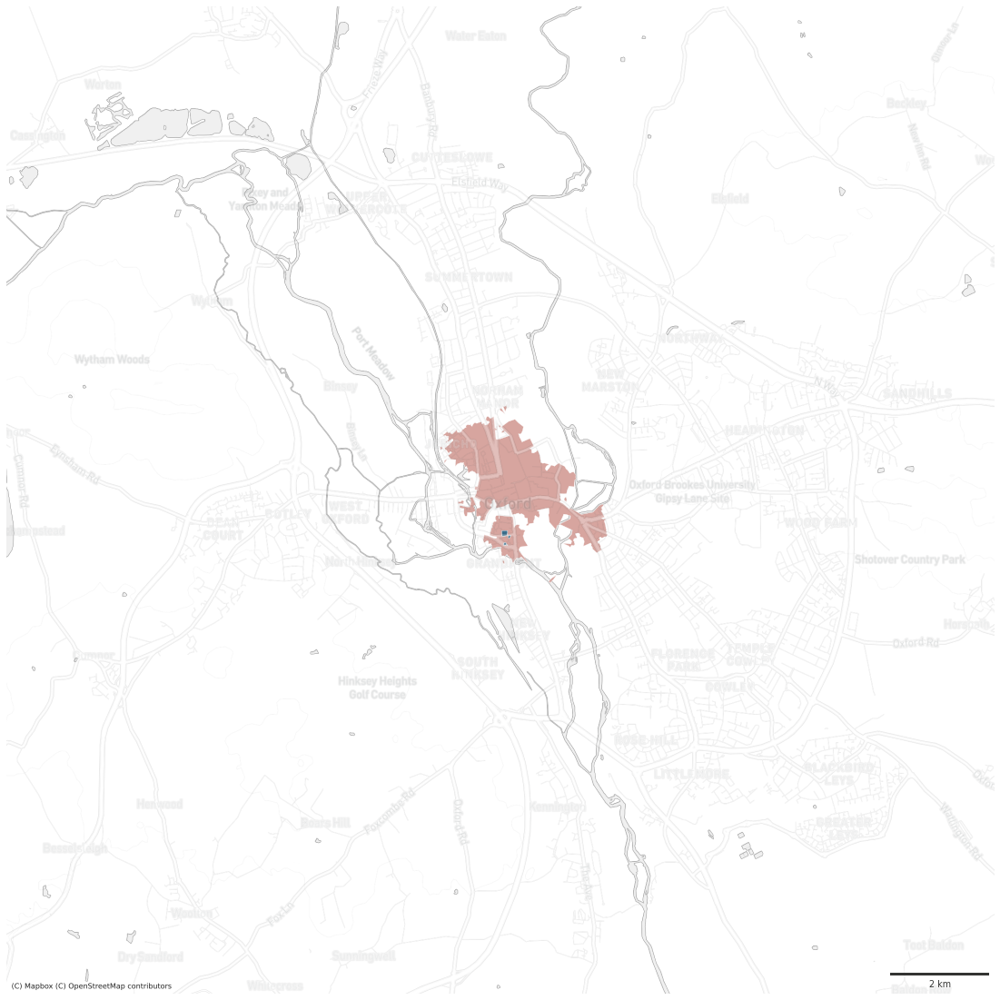

In [ ]:
bm_centre = gpd.GeoSeries([Point(-1.2592259773810732, 51.75248412082885)], crs=4326).to_crs(3857).buffer(10000).total_bounds

selection = ['4_0', '4_1', '4_2', '4_3', '4_4', '4_5', '4_6', '4_7', '4_8']
ax = df[df.signature_type.isin(selection)].plot(color=df[df.signature_type.isin(selection)]['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(bm_centre[0], bm_centre[2])
ax.set_ylim(bm_centre[1], bm_centre[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
# contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_centres_oxford.png", dpi=72, bbox_inches="tight")

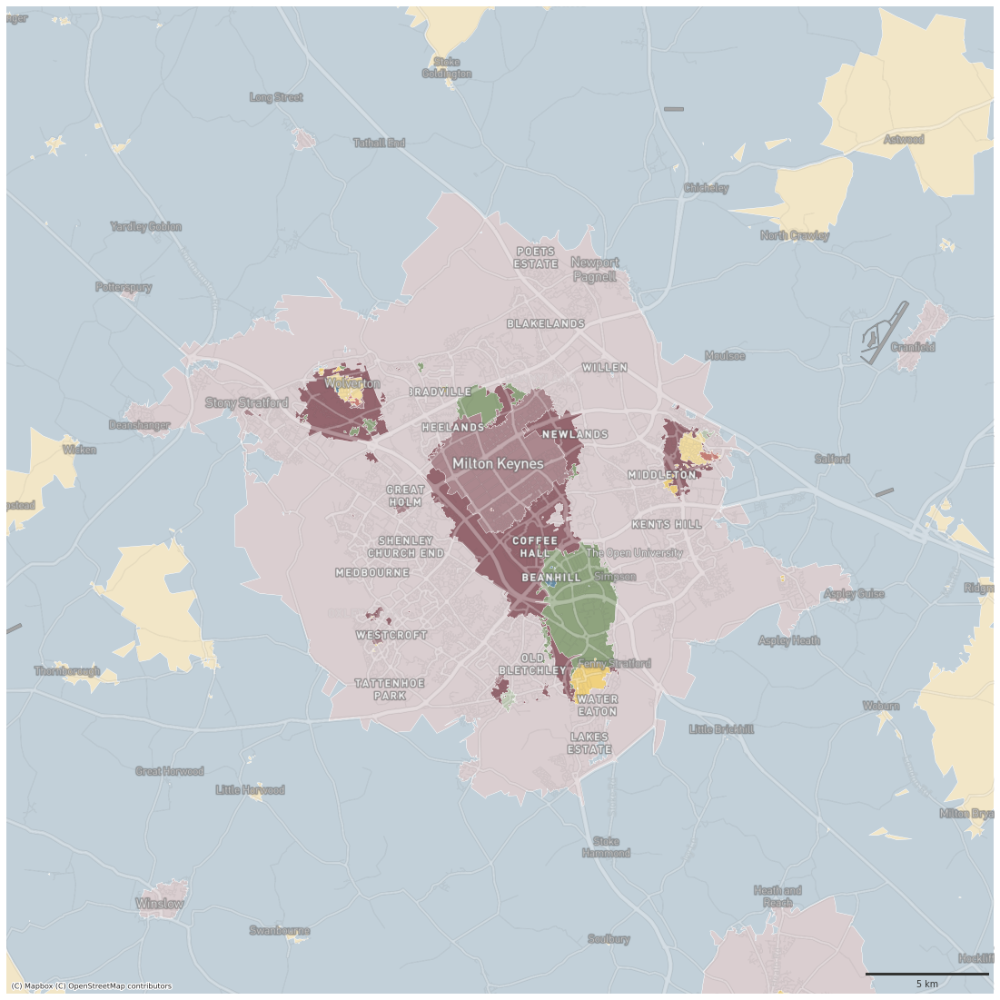

In [ ]:
mk = gpd.GeoSeries([Point(-0.7580666354676765, 52.03497622437312)], crs=4326).to_crs(3857).buffer(20000).total_bounds

ax = df.plot(color=df['signature_type'].map(symbology), figsize=(20, 20), zorder=1, linewidth=.3, edgecolor='w', alpha=1)

ax.set_xlim(mk[0], mk[2])
ax.set_ylim(mk[1], mk[3])

contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('roads', token), zorder=2, alpha=.3)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('labels', token), zorder=3, alpha=1)
contextily.add_basemap(ax, crs=df.crs, source=ugg.get_tiles('background', token), zorder=-1, alpha=1)
ax.set_axis_off()

scalebar = ScaleBar(dx=1,
                    color=ugg.COLORS[0],
                    location='lower right',
                    height_fraction=0.002,
                    pad=.5,
                    frameon=False,
                    )
ax.add_artist(scalebar)

# ugg.north_arrow(plt.gcf(), ax, 0, size=.05, linewidth=1, color=ugg.COLORS[0], loc="upper left", pad=.002, alpha=.9)

# custom_points = [Line2D([0], [0], marker="o", linestyle="none", markersize=10, color=color) for color in symbology.values()]
# leg_points = ax.legend(custom_points, symbology.keys(), bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
# ax.add_artist(leg_points)
plt.savefig("figures/form_keynes.png", dpi=72, bbox_inches="tight")